# Study of boundary conditions in splitting methods

# Table of Contents
* [First test case : linear advection-diffusion equation](#First-test-case-:-linear-advection-diffusion-equation)
	* [Validation : Linear advection](#Validation-:-Linear-advection)
	* [Validation : Heat equation](#Validation-:-Heat-equation)
	* [Splitting method](#Splitting-method)
* [Second test case : Halpern](#Second-test-case-:-Halpern)
	* [Reference solution](#Reference-solution)
	* [Comparison of the solutions on $[0,1]$](#Comparison-of-the-solutions-on-$[0,1]$)
	* [Comparison of the solutions on the boundary $x = 1$](#Comparison-of-the-solutions-on-the-boundary-$x-=-1$)
		* [Error on the boundary](#Error-on-the-boundary)
	* [Validation : Halpern discretization for the diffusion equation](#Validation-:-Halpern-discretization-for-the-diffusion-equation)
	* [Validation : Halpern discretization for the transport equation](#Validation-:-Halpern-discretization-for-the-transport-equation)


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import generalFunctions as gf

%matplotlib inline

# First test case : linear advection-diffusion equation

\begin{equation}
u_t + au_x - \epsilon u_xx = 0
\end{equation}

In [2]:
def linearAdvectionSolver(x,u,bc,a,dx,dt) :
    u2 = np.copy(u)
    u2[1:] = u[1:] - a*dt*(u[1:]-u[:-1])/dx
    u2[0] = u2[1]
    
    return u2 

In [3]:
def heatEquationSolver(x,u,bc,a,eps,dx,dt) :
    u2 = np.copy(u)
    k = dt*eps/(2.*dx*dx)
    z = a*dt/(dx)
    
    N = x.size
    
    d0 = np.ones(N)*(1 + 2.*k)
    d1 = -np.ones(N-1)*(k)
    
    M = np.diag(d0) + np.diag(d1,1) + np.diag(d1,-1)
    M[0,:] = 0.
    M[0,0] = 1.
    M[0,1] = -1
    M[-1,:] = 0.
    M[-1,-1] = 1.
    M[-1,-2] = -1.
    #M[-1,-1] = 1. + z
    #M[-1,-2] = - z
    
    rhs = np.zeros_like(u)
    rhs[1:-1] = k*u[0:-2] + (1 - 2.*k)*u[1:-1] + k*u[2:]
    rhs[0] = bc[0]
    rhs[-1] = bc[1]
    #rhs[-1] = u[-1]
    
    u2 = np.linalg.solve(M,rhs)

    
    return u2


In [4]:
def fullEquationSolver(x,u,bc,a,eps,dx,dt) :
    u2 = np.copy(u)
    k = dt*eps/(2.*dx*dx)
    z = a*dt/(dx)
    
    N = x.size
    
    d0 = np.ones(N)*(1 + 2.*k)
    d1 = np.ones(N-1)*(-k)
    d2 = np.ones(N-1)*(-k)
    
    M = np.diag(d0) + np.diag(d1,1) + np.diag(d2,-1)
    M[0,:] = 0.
    M[0,0] = 1.
    M[0,1] = -1
    M[-1,:] = 0.
    #M[-1,-1] = 1.
    #M[-1,-2] = -1.
    M[-1,-1] = 1. + z
    M[-1,-2] = - z
    
    rhs = np.zeros_like(u)
    rhs[1:-1] = (k+z)*u[0:-2] + (1 - 2.*k - z)*u[1:-1] + k*u[2:]
    rhs[0] = bc[0]
    rhs[-1] = u[-1]
    
    u2 = np.linalg.solve(M,rhs)

    
    return u2


In [5]:
def fullEquationSolverNeumann(x,u,bc,a,eps,dx,dt) :
    u2 = np.copy(u)
    k = dt*eps/(2.*dx*dx)
    z = a*dt/(dx)
    
    N = x.size
    
    d0 = np.ones(N)*(1 + 2.*k)
    d1 = np.ones(N-1)*(-k)
    d2 = np.ones(N-1)*(-k)
    
    M = np.diag(d0) + np.diag(d1,1) + np.diag(d2,-1)
    M[0,:] = 0.
    M[0,0] = 1.
    M[0,1] = -1
    M[-1,:] = 0.
    M[-1,-1] = 1.
    M[-1,-2] = -1.
    
    rhs = np.zeros_like(u)
    rhs[1:-1] = (k+z)*u[0:-2] + (1 - 2.*k - z)*u[1:-1] + k*u[2:]
    rhs[0] = bc[0]
    rhs[-1] = bc[1]
    
    u2 = np.linalg.solve(M,rhs)

    
    return u2


## Validation : Linear advection

*** Plotting animation ...



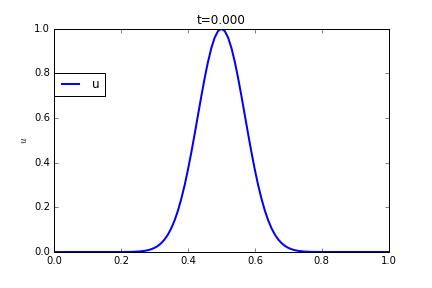
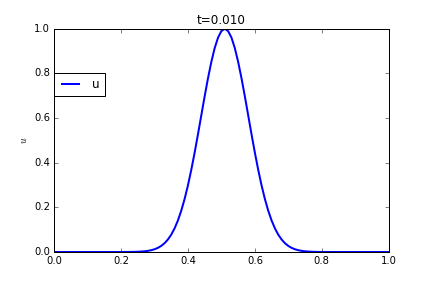
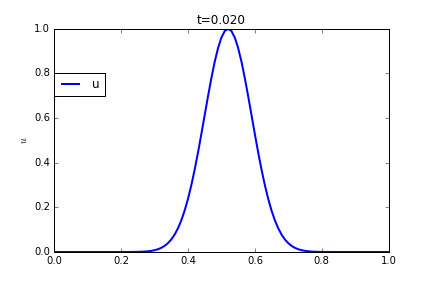
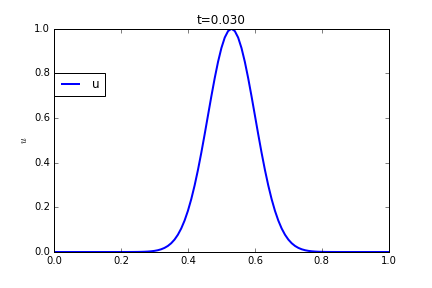
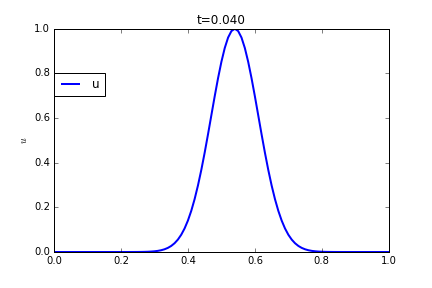
...
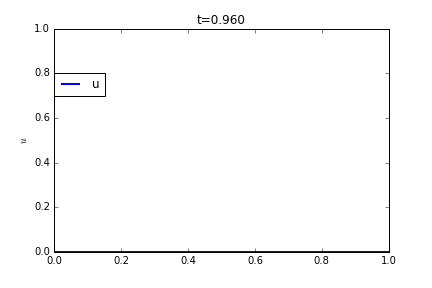
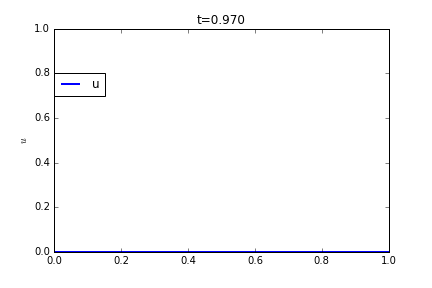
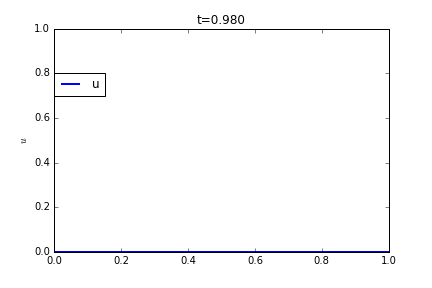
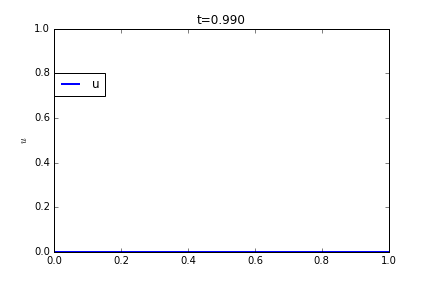
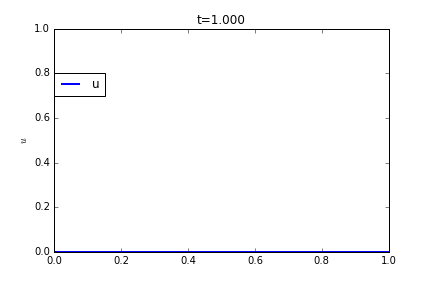

In [124]:
N = 101
xmin = 0.
xmax = 1.
xc = (xmin+xmax)/2.
x = np.linspace(xmin,xmax,N)
dx = x[1]-x[0]
dt = dx
tmax = 1.


sigma = 0.1
u = 1.*np.exp(-np.power((x-xc)/sigma,2))
u0 = u

a = 1.

t = 0
uall = np.copy(u)
tall = np.copy(t)
while t < tmax:
    t = t + dt
    u = linearAdvectionSolver(x,u,0.,a,dx,dt)
    uall = np.column_stack((uall,u))
    tall = np.hstack((tall,t*np.ones(1)))

utransportref = np.copy(uall)
gf.plotAnimationNSolutions(1,x,np.array([uall]),tall,xmin,xmax,0.,1.,'u',ylabel=r'$u$',location=(0.,.7))

## Validation : Heat equation

*** Plotting animation ...



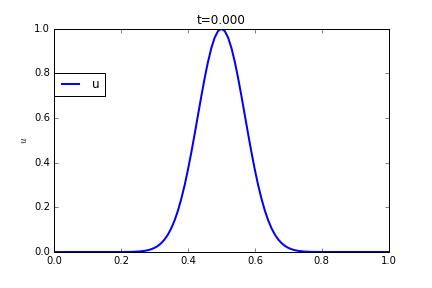
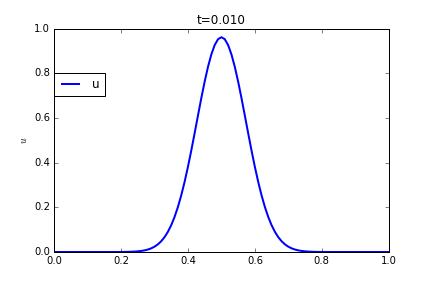
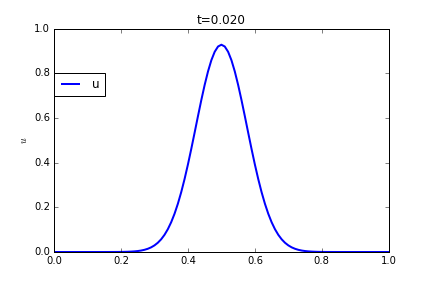
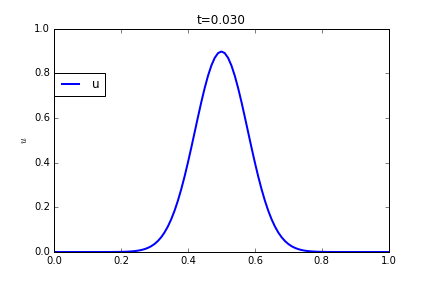
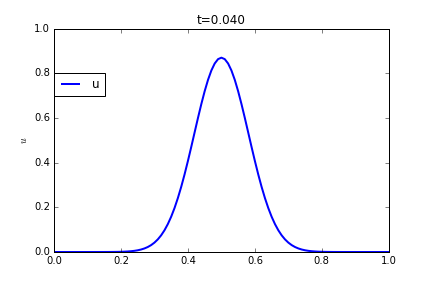
...
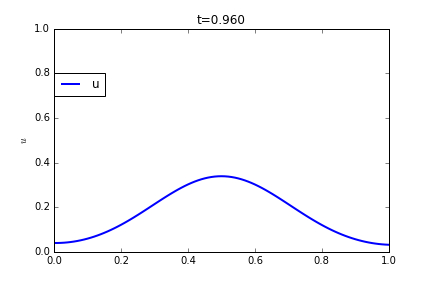
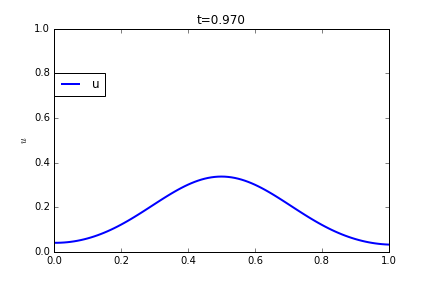
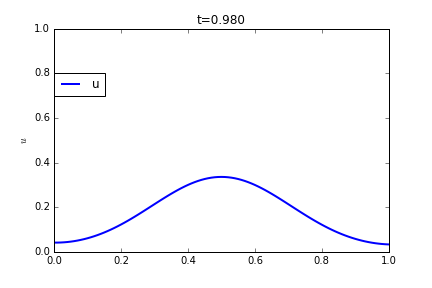
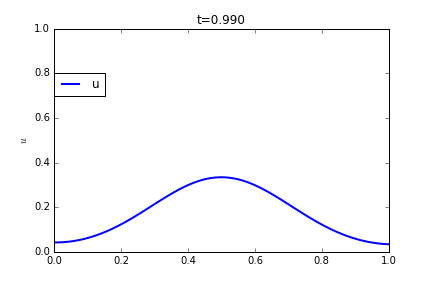
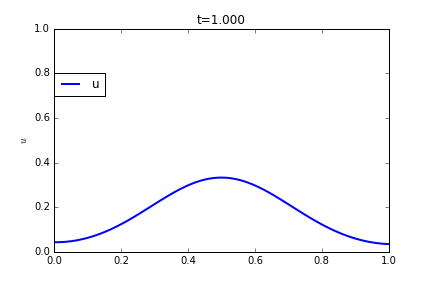

In [117]:
N = 101
xmin = 0.
xmax = 1.
xc = (xmin+xmax)/2.
x = np.linspace(xmin,xmax,N)
dx = x[1]-x[0]
dt = dx
tmax = 1.


sigma = 0.1
u = 1.*np.exp(-np.power((x-xc)/sigma,2))
u0 = u

t = 0
eps = .02
uall = np.copy(u)
tall = np.copy(t)
while t < tmax:
    t = t + dt
    u = heatEquationSolver(x,u,[0.,0],1.,eps,dx,dt)
    uall = np.column_stack((uall,u))
    tall = np.hstack((tall,t*np.ones(1)))

uheatref = np.copy(uall)
gf.plotAnimationNSolutions(1,x,np.array([uall]),tall,xmin,xmax,0.,1.,'u',ylabel=r'$u$',location=(0.,.7))

## Splitting method

*** Plotting animation ...



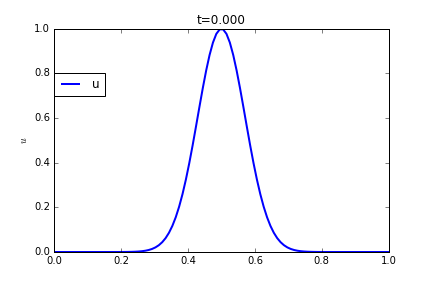
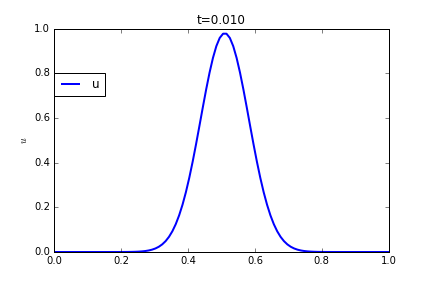
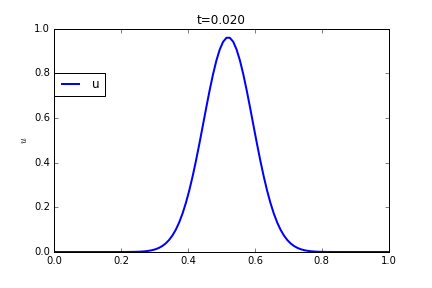
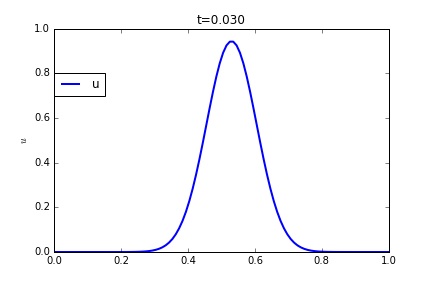
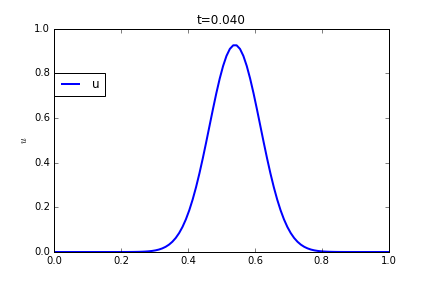
...
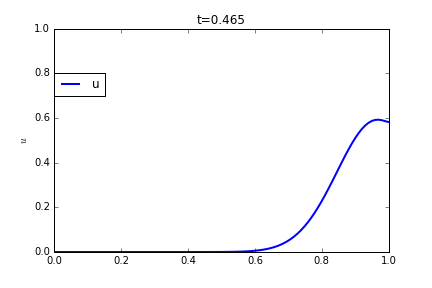
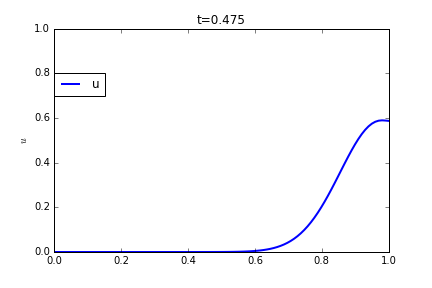
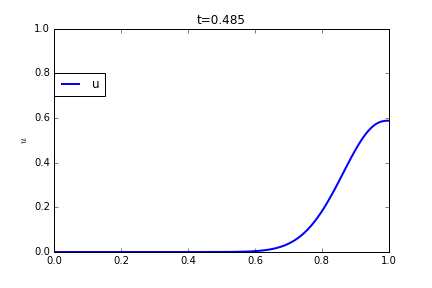
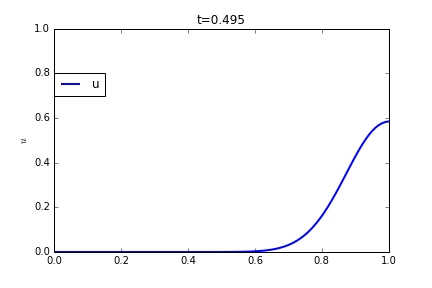
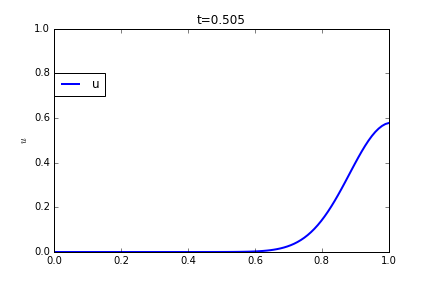

In [9]:
N = 100
xmin = 0.
xmax = 1.
xc = (xmin+xmax)/2.
x = np.linspace(xmin,xmax,N)
dx = x[1]-x[0]
dt = dx
tmax = .5


sigma = 0.1
u = 1.*np.exp(-np.power((x-xc)/sigma,2))
u0 = u

a = 1.
t = 0
eps = 0.01
uall = np.copy(u)
tall = np.copy(t)
while t < tmax:
    t = t + dt
    u = linearAdvectionSolver(x,u,0.,a,dx,dt)
    u = heatEquationSolver(x,u,[0.,0],a,eps,dx,dt)
    uall = np.column_stack((uall,u))
    tall = np.hstack((tall,t*np.ones(1)))
    
gf.plotAnimationNSolutions(1,x,np.array([uall]),tall,xmin,xmax,0.,1.,'u',ylabel=r'$u$',location=(0.,.7))

((100, 51), (100, 51))
*** Plotting animation ...



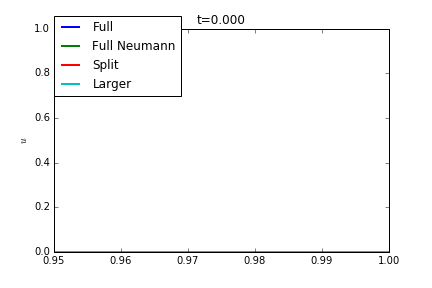
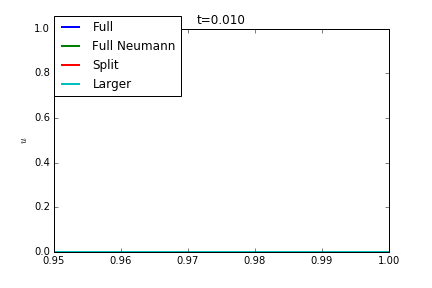
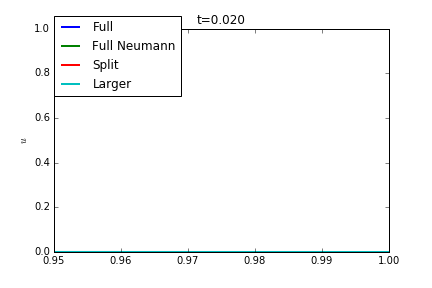
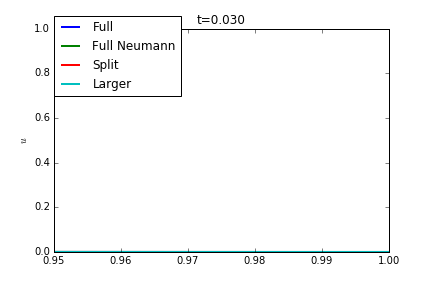
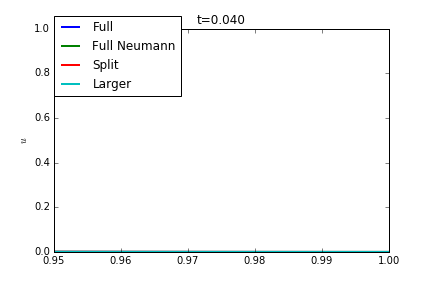
...
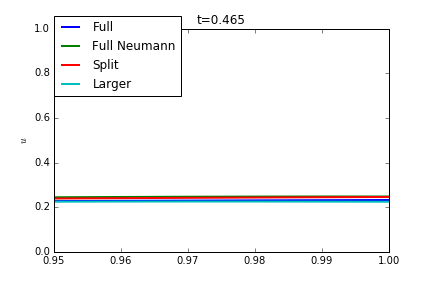
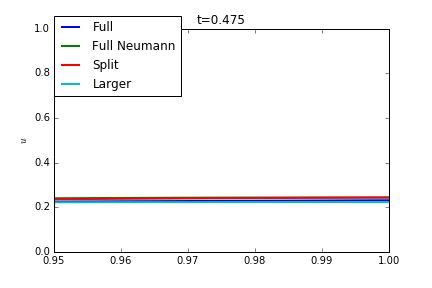
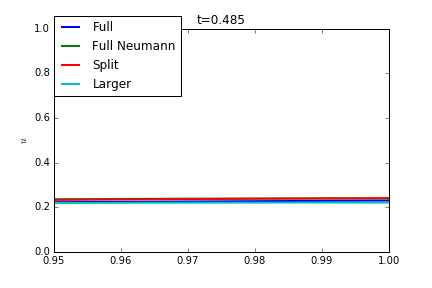
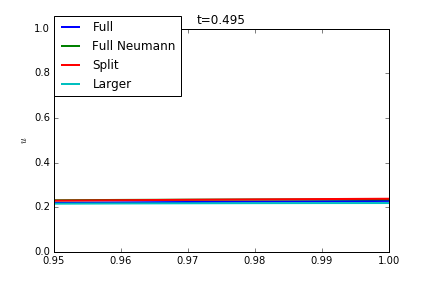
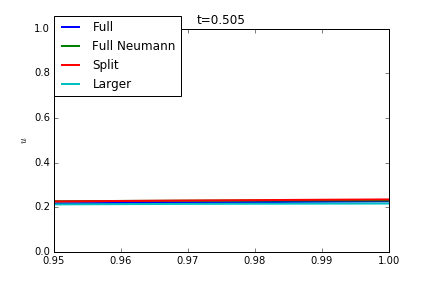

In [106]:
N = 100
N3 = 2*N-1
xmin = 0.
xmax = 1.
xmax3 = 2.
xc = .5#(xmin+xmax)/2.
x = np.linspace(xmin,xmax,N)
x3 = np.linspace(xmin,xmax3,N3)
dx = x[1]-x[0]
dt = dx
tmax = .5

sigma = 0.1
u = 1.*np.exp(-np.power((x-xc)/sigma,2))
u3 = 1.*np.exp(-np.power((x3-xc)/sigma,2))
u0 = u

a = 1.
t = 0
eps = 0.1
uall1 = np.copy(u)
tall1 = np.copy(t)
uall2 = np.copy(u)
tall2 = np.copy(t)
uall4 = np.copy(u)
tall4 = np.copy(t)
uall3 = np.copy(u3)
tall3 = np.copy(t)
u1 = np.copy(u)
u2 = np.copy(u)
u4 = np.copy(u)

while t < tmax:
    t = t + dt
    u1 = fullEquationSolver(x,u1,[0.,0],a,eps,dx,dt)
    uall1 = np.column_stack((uall1,u1))
    tall1 = np.hstack((tall1,t*np.ones(1)))
    u4 = fullEquationSolverNeumann(x,u4,[0.,0],a,eps,dx,dt)
    uall4 = np.column_stack((uall4,u4))
    tall4 = np.hstack((tall4,t*np.ones(1)))
    u2 = linearAdvectionSolver(x,u2,0.,a,dx,dt)
    u2 = heatEquationSolver(x,u2,[0.,0],a,eps,dx,dt)
    uall2 = np.column_stack((uall2,u2))
    tall2 = np.hstack((tall2,t*np.ones(1)))
    u3 = fullEquationSolver(x3,u3,[0.,0],a,eps,dx,dt)
    uall3 = np.column_stack((uall3,u3))
    tall3 = np.hstack((tall3,t*np.ones(1)))

uall3b = uall3[0:N,:]
print(uall1.shape,uall3b.shape)

udif = np.absolute(uall1- uall2)
ymax = np.amax(udif)
ymin = np.amin(udif)
gf.plotAnimationNSolutions(4,x,np.array([uall1,uall4,uall2,uall3b]),tall,.95,xmax,0.,1.,np.array(['Full','Full Neumann','Split','Larger']),ylabel=r'$u$',location=(0.,.7))

*** Plotting animation ...



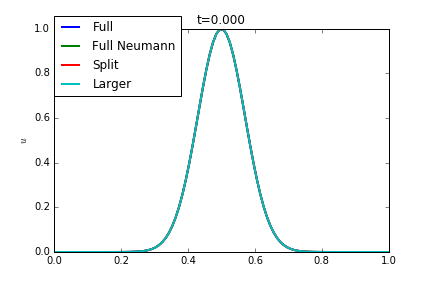
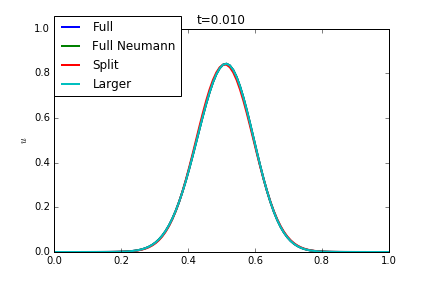
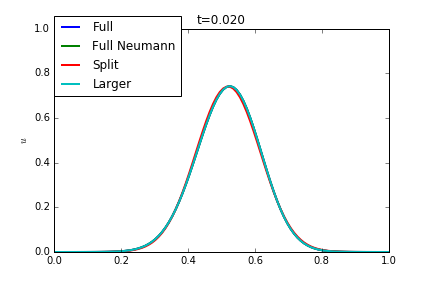
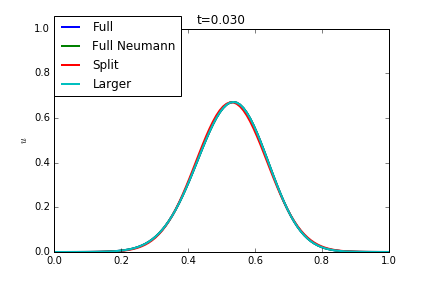
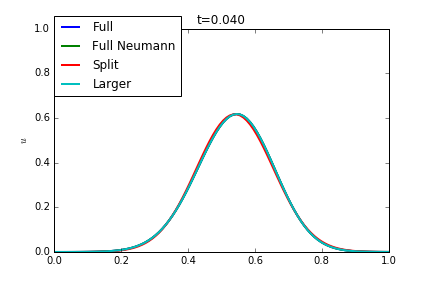
...
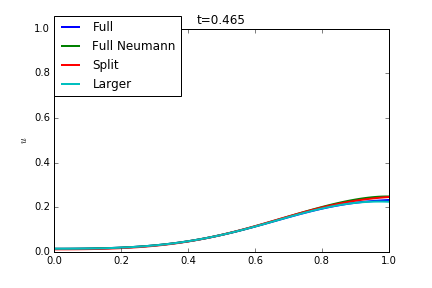
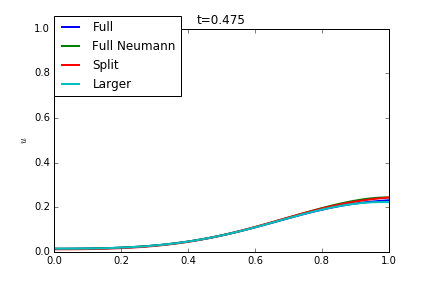
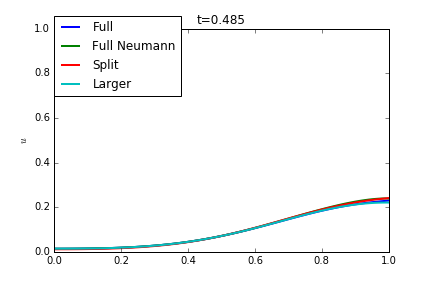
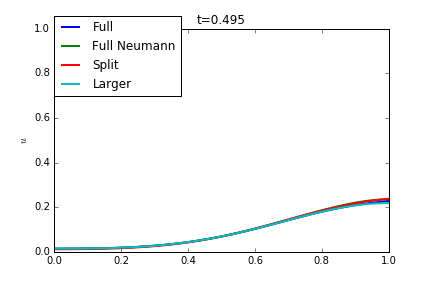
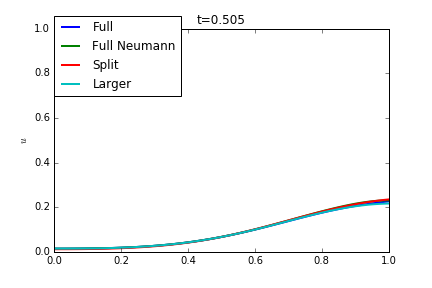

In [11]:
gf.plotAnimationNSolutions(4,x,np.array([uall1,uall4,uall2,uall3b]),tall,xmin,xmax,0.,1.,np.array(['Full','Full Neumann','Split','Larger']),ylabel=r'$u$',location=(0.,.7))

*** Plotting animation ...



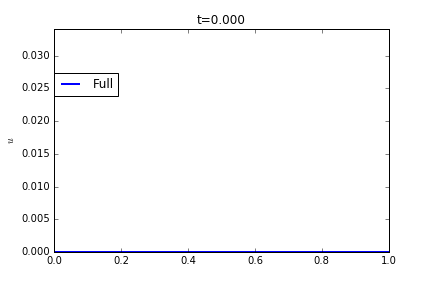
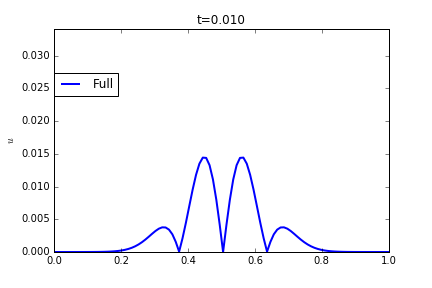
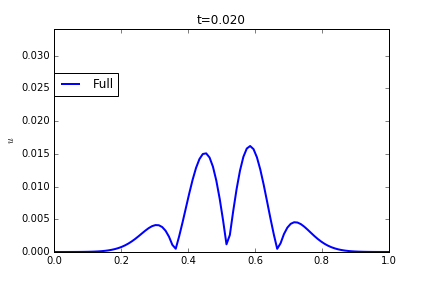
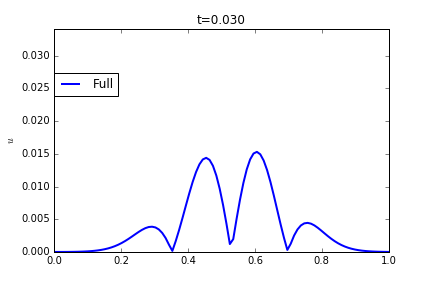
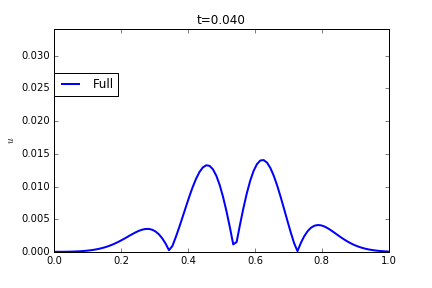
...
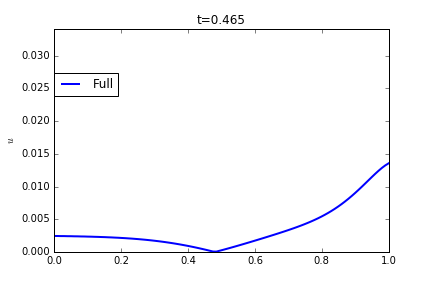
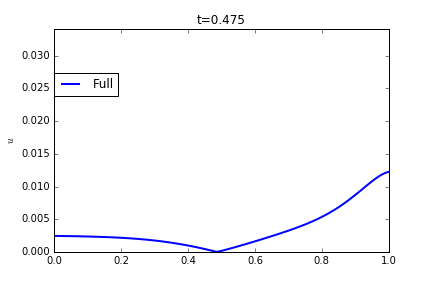
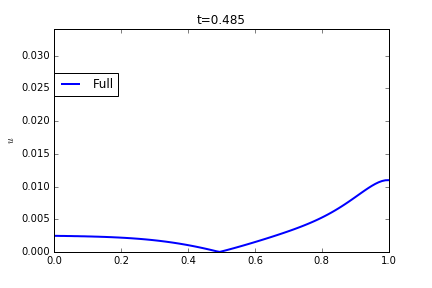
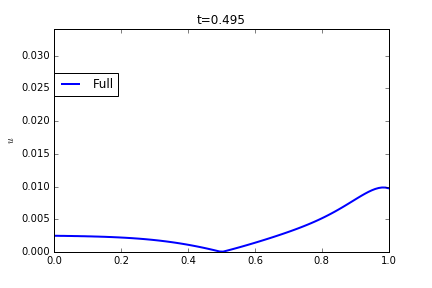
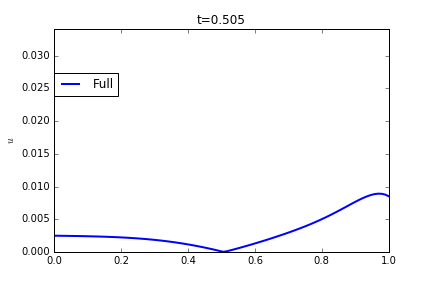

In [12]:

gf.plotAnimationNSolutions(1,x,np.array([udif]),tall,xmin,xmax,ymin,ymax,np.array(['Full','Split']),ylabel=r'$u$',location=(0.,.7))

# Second test case : Halpern

In [13]:
def g(t) :
    return np.sin(t)/np.sqrt(t*t+1.)

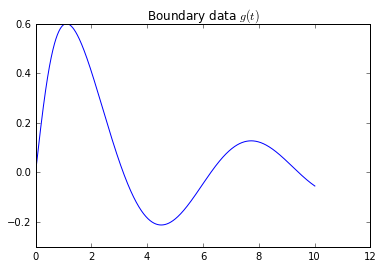

In [51]:
plt.plot(tall1,g(tall1))
plt.title("Boundary data $g(t)$")

In [112]:
def fullEquationSolverHalpern(x,u,uprev1,uprev2,bc,a,eps,dx,dt,t,g) :
    u2 = np.copy(u)
    k = dt*eps/(2.*dx*dx)
    z = a*dt/(4.*dx)
    b = dt/(2.*dx)
    d = dt/dx
    e = dt*dt/(2.*dx*dx)
    
    N = x.size
    
    d0 = np.ones(N)*(1 + 2.*k)
    d1 = np.ones(N-1)*(z-k)
    d2 = np.ones(N-1)*(-z-k)
    
    M = np.diag(d0) + np.diag(d1,1) + np.diag(d2,-1)
    rhs = np.zeros_like(u)
    rhs[1:-1] = (k+z)*u[0:-2] + (1. - 2.*k)*u[1:-1] + (k-z)*u[2:]  + 0.*( -u[1:-1] + (u[0:-2] +  u[2:])/2. )
    
    M[0,:] = 0.
    M[0,0] = 1.
    rhs[0] = g(t)
    
    M[-1,:] = 0.
    if bc == -2 : # Neumann L and R
        M[0,:] = 0.
        M[0,0] = 1.
        M[0,1] = -1
        rhs[0] = 0   
        M[-1,:] = 0.
        M[-1,-1] = 1.
        M[-1,-2] = -1
        rhs[-1] = 0 
    elif bc == -1: # Uncentered discretization of u_x in R
        M[-1,-1] = 1. + 2.*z
        M[-1,-2] = -2.*z
        rhs[-1] = 2.*z*u[-2] + (1. - 2.*z)*u[-1]
    elif bc == 0 : # B0
        M[-1,-1] = 1.
        M[-1,-2] = -1.
        rhs[-1] = 0.
    elif bc == 1 : # B1
        M[-1,-1] = 1. + b
        M[-1,-2] = -b
        rhs[-1] = (1. - b)*u[-1] + b*u[-2]
    elif bc == 2 : # B2
        M[-1,-1] = 1. + d + e
        M[-1,-2] = -d - 2.*e
        M[-1,-3] = e
        rhs[-1] = +2.*u[-1] - (1. - d + e)*uprev1[-1]  - (d - 2.*e)*uprev1[-2] - e*uprev1[-3]
          
    u2 = np.linalg.solve(M,rhs)
    
    return u2


In [152]:
N = 101
Nref = 2*N-1
xmin = 0.
xmax = 1.
xmaxref = 2.
xc = .5#(xmin+xmax)/2.
x = np.linspace(xmin,xmax,N)
xref = np.linspace(xmin,xmaxref,Nref)
dx = x[1]-x[0]
dt = dx
print(dx,xref[1]-xref[0])
print(x[N-1],xref[N-1])
tmax = 5.


sigma = 0.1
u = np.zeros_like(x)
uref = np.zeros_like(xref)
u0 = np.copy(u)

eps = 0.02

t = 0

uall1 = np.copy(u)
tall1 = np.copy(t)
uall2 = np.copy(u)
tall2 = np.copy(t)
uall3 = np.copy(u)
tall3 = np.copy(t)
uall4 = np.copy(u)
tall4 = np.copy(t)
uall5 = np.copy(u)
tall5 = np.copy(t)
uall6 = np.copy(u)
tall6 = np.copy(t)
uall7 = np.copy(u)
tall7 = np.copy(t)
uallref = np.copy(uref)
tallref = np.copy(t)
u1 = np.copy(u)
u2 = np.copy(u)
u3 = np.copy(u)
u4 = np.copy(u)
u5 = np.copy(u)
u6 = np.copy(u)
u7 = np.copy(u)
uprev1 = np.copy(u1)
uprev2 = np.copy(u1)
uprev1ref = np.copy(uref)
uprev2ref = np.copy(uref)

while t < tmax:
    t = t + dt
    
    uprev2 = uprev1
    uprev1 = u3
    
    uprev2ref = uprev1ref
    uprev1ref = uref
    
    u1 = fullEquationSolverHalpern(x,u1,uprev1,uprev2,0,1.,0.02,dx,dt,t,g) # B0
    uall1 = np.column_stack((uall1,u1))
    tall1 = np.hstack((tall1,t*np.ones(1)))
    
    u2 = fullEquationSolverHalpern(x,u2,uprev1,uprev2,1,1.,0.02,dx,dt,t,g) # B1
    uall2 = np.column_stack((uall2,u2))
    tall2 = np.hstack((tall2,t*np.ones(1)))
    
    u3 = fullEquationSolverHalpern(x,u3,uprev1,uprev2,2,1.,0.02,dx,dt,t,g) # B2
    uall3 = np.column_stack((uall3,u3))
    tall3 = np.hstack((tall3,t*np.ones(1)))
    
    u4 = fullEquationSolverHalpern(x,u4,uprev1,uprev2,-1,1.,0.,dx,dt,t,g) # Transport = split.1
    uall4 = np.column_stack((uall4,u4))
    tall4 = np.hstack((tall4,t*np.ones(1)))
    
    u5 = np.copy(u4)
    u5 = fullEquationSolverHalpern(x,u5,uprev1,uprev2,1,0.,0.02,dx,dt,t,g) # Difusion = split.2
    uall5 = np.column_stack((uall5,u5))
    tall5 = np.hstack((tall5,t*np.ones(1)))
    
    u6 = fullEquationSolverHalpern(x,u6,uprev1,uprev2,1,0.,0.02,dx,dt,t,g) # Difusion = splitB.1
    u6 = fullEquationSolverHalpern(x,u6,uprev1,uprev2,-1,1.,0.,dx,dt,t,g) # Transport = splitB.2
    uall6 = np.column_stack((uall6,u6))
    tall6 = np.hstack((tall6,t*np.ones(1)))

    u7 = fullEquationSolverHalpern(x,u7,uprev1,uprev2,-1,1.,0.,dx,dt/2.,t,g) # Transport = splitC.1
    u7 = fullEquationSolverHalpern(x,u7,uprev1,uprev2,1,0.,0.02,dx,dt,t,g) # Difusion = splitC.2
    u7 = fullEquationSolverHalpern(x,u7,uprev1,uprev2,-1,1.,0.,dx,dt/2.,t,g) # Transport = splitC.3
    uall7 = np.column_stack((uall7,u7))
    tall7 = np.hstack((tall7,t*np.ones(1)))
    
    uref = fullEquationSolverHalpern(xref,uref,uprev1ref,uprev2ref,2,1.,0.02,dx,dt,t,g) # Reference
    uallref = np.column_stack((uallref,uref))
    tallref = np.hstack((tallref,t*np.ones(1)))
    
uallrefb = uallref[0:N,:]
print(uall1.shape,uallrefb.shape)

udif = np.absolute(uall1- uall2)
ymax = np.amax(uall1)
ymin = np.amin(uall1)

(0.01, 0.01)
(1.0, 1.0)
((101, 502), (101, 502))


## Reference solution

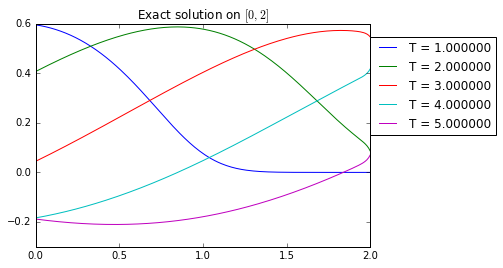

In [61]:
plt.figure()
it = np.int(1./dt)
plt.plot(xref,uallref[:,it],label=r'T = %f' %tallref[it])
it = np.int(2./dt)
plt.plot(xref,uallref[:,it],label=r'T = %f' %tallref[it])
it = np.int(3./dt)
plt.plot(xref,uallref[:,it],label=r'T = %f' %tallref[it])
it = np.int(4./dt)
plt.plot(xref,uallref[:,it],label=r'T = %f' %tallref[it])
it = np.int(5./dt)
plt.plot(xref,uallref[:,it],label=r'T = %f' %tallref[it])
plt.legend(loc = (1.,.5))
plt.title("Exact solution on $[0,2]$")

## Comparison of the solutions on $[0,1]$

*** Plotting animation ...



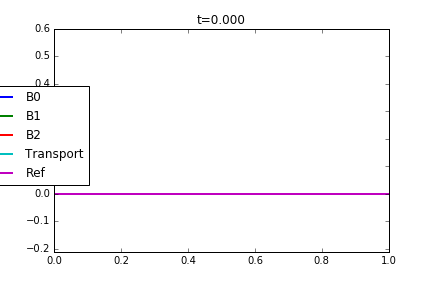
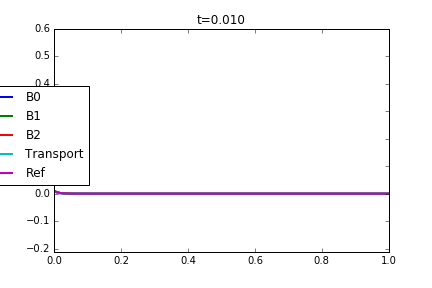
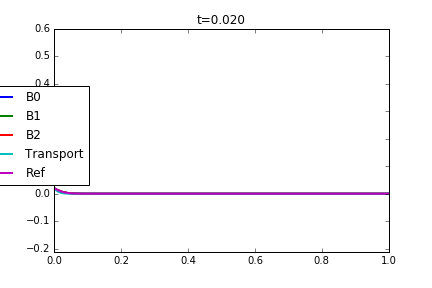
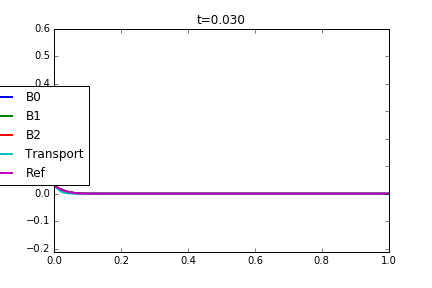
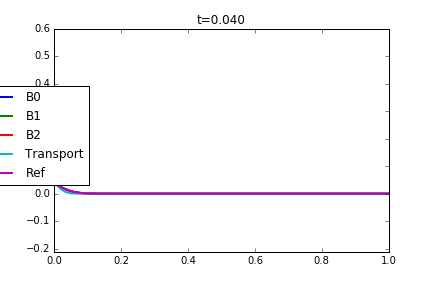
...
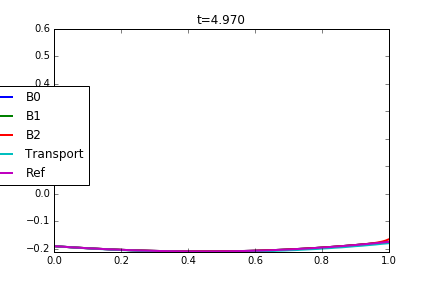
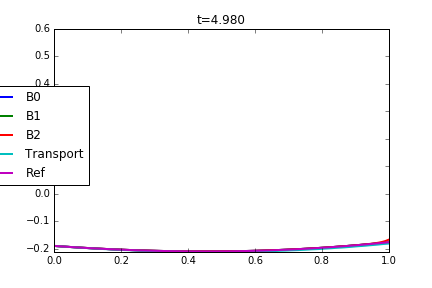
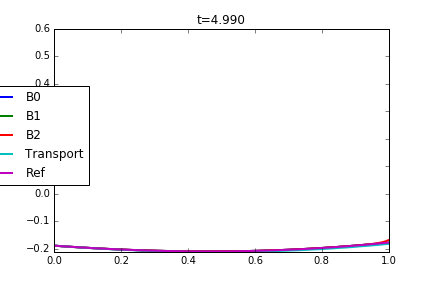
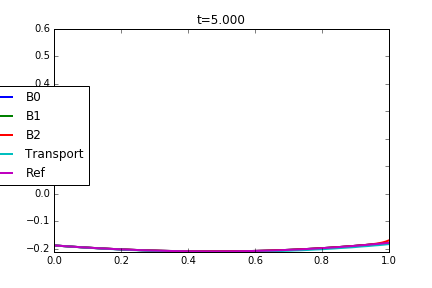
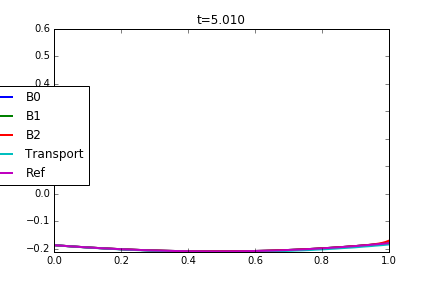

In [148]:
gf.plotAnimationNSolutions(5,x,np.array([uall1,uall2,uall3,uall4,uallrefb]),tall1,xmin,xmax,ymin,ymax,np.array(['B0','B1','B2','Transport','Ref']),ylabel=r'$u$',location=(-.2,.3))

*** Plotting animation ...



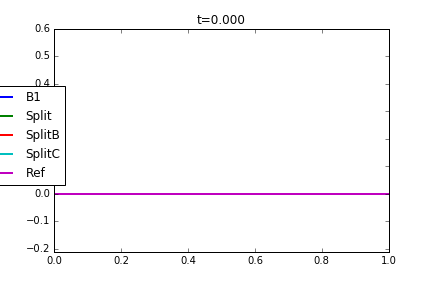
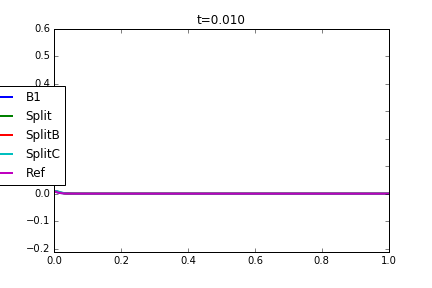
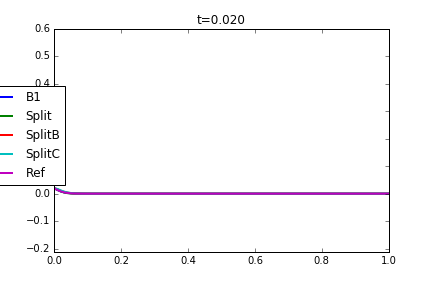
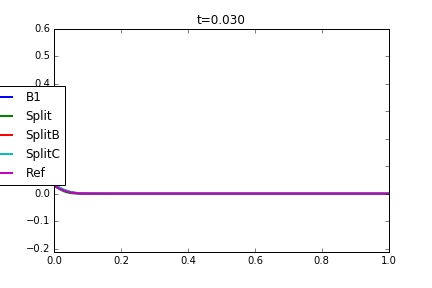
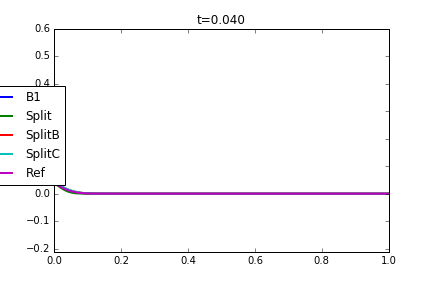
...
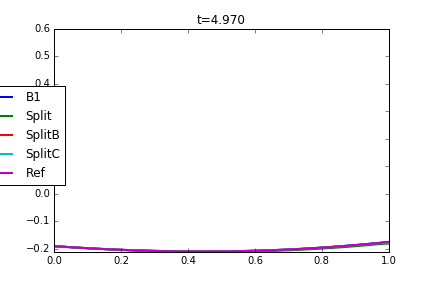
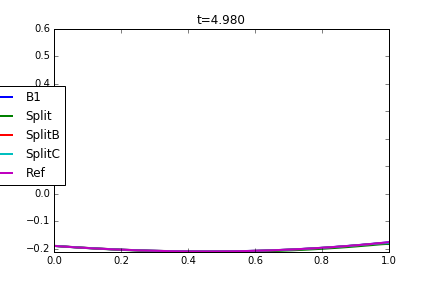
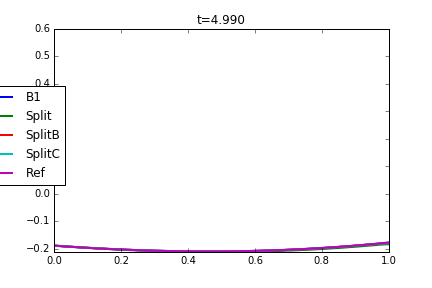
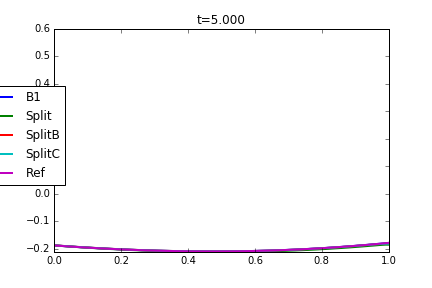
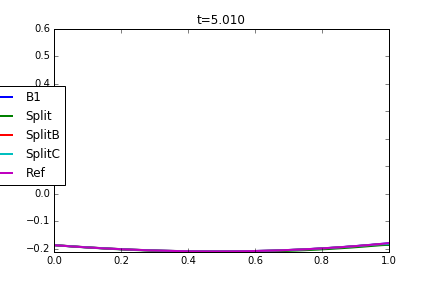

In [149]:
gf.plotAnimationNSolutions(5,x,np.array([uall2,uall5,uall6,uall7,uallrefb]),tall1,xmin,xmax,ymin,ymax,np.array(['B1','Split','SplitB','SplitC','Ref']),ylabel=r'$u$',location=(-.2,.3))

## Comparison of the solutions on the boundary $x = 1$

*** Plotting animation ...



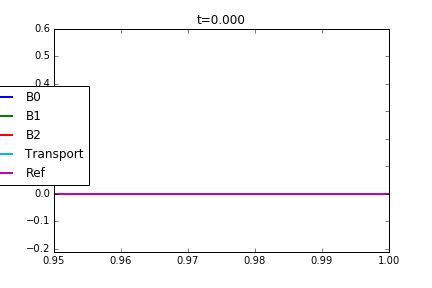
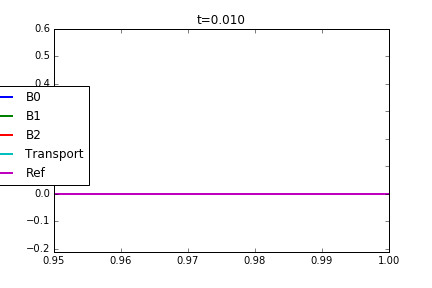
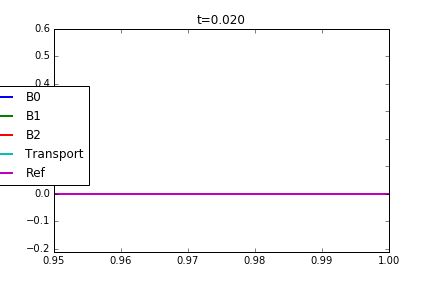
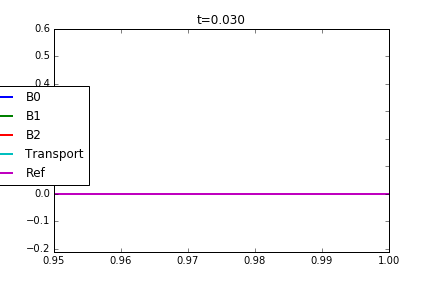
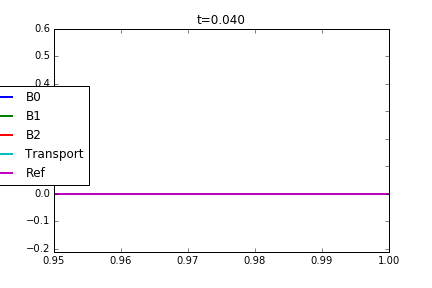
...
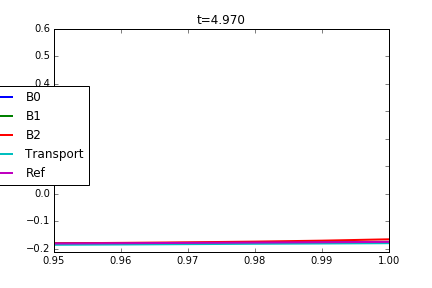
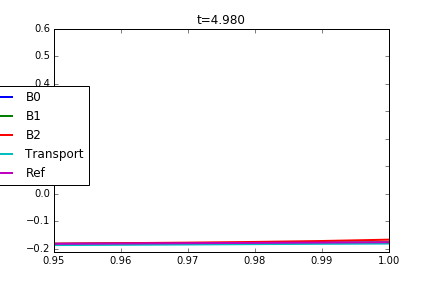
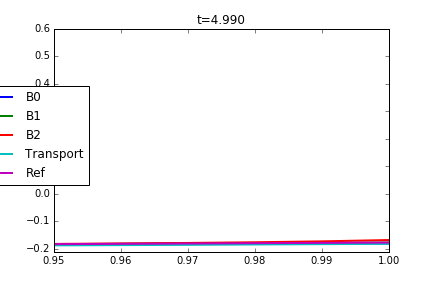
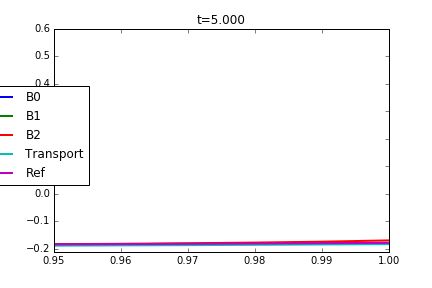
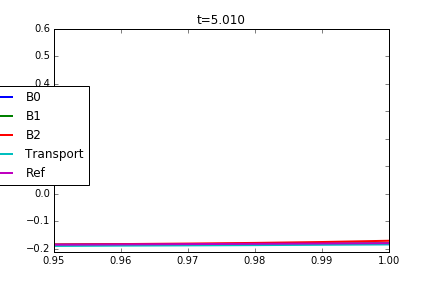

In [150]:
gf.plotAnimationNSolutions(5,x,np.array([uall1,uall2,uall3,uall4,uallrefb]),tall1,.95,xmax,ymin,ymax,np.array(['B0','B1','B2','Transport','Ref']),ylabel=r'$u$',location=(-.2,.3))

*** Plotting animation ...



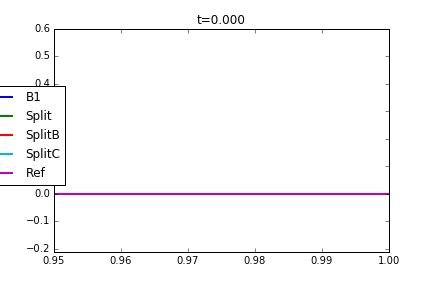
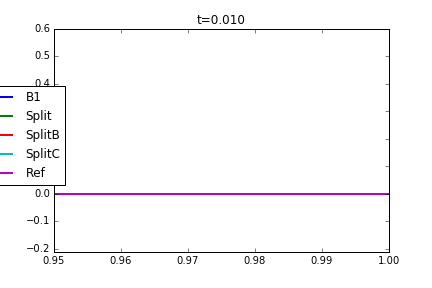
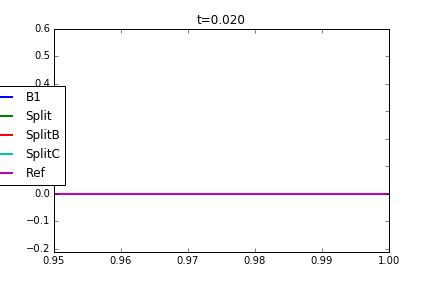
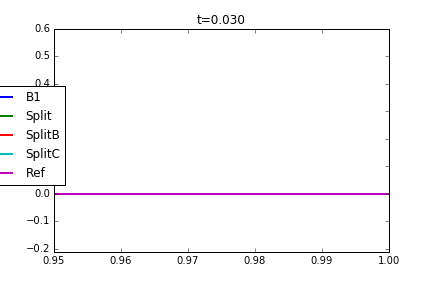
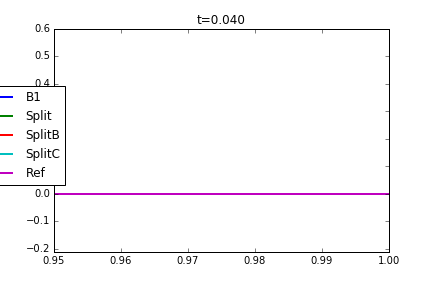
...
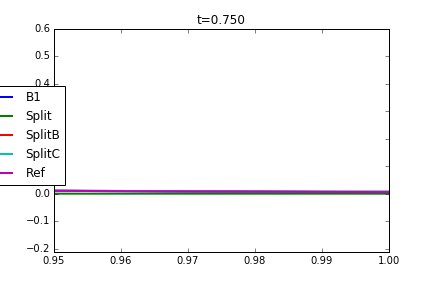
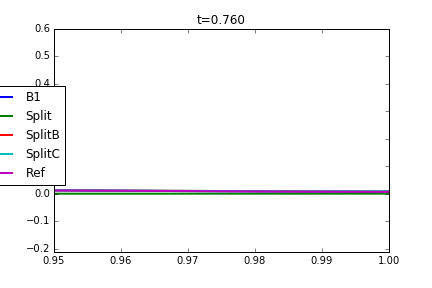
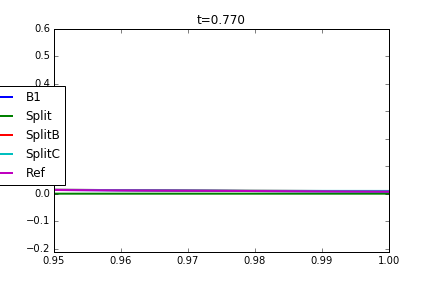
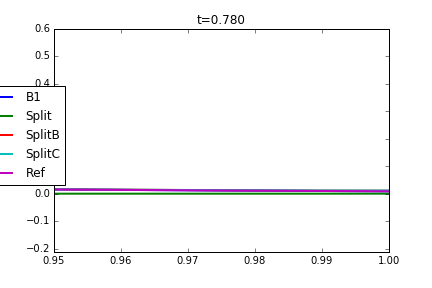
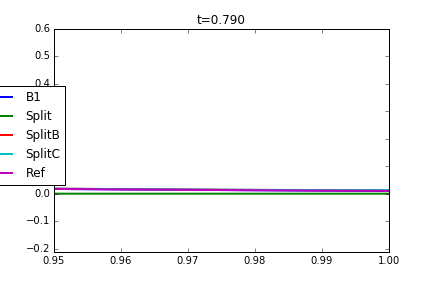

In [151]:
gf.plotAnimationNSolutions(5,x,np.array([uall2,uall5,uall6,uall7,uallrefb]),tall1,.95,xmax,ymin,ymax,np.array(['B1','Split','SplitB','SplitC','Ref']),ylabel=r'$u$',location=(-.2,.3))

In [37]:
def plotError(err,t,title,leg) :
    plt.figure()
    plt.plot(t,err,label=leg)
    plt.xlabel('$t$')
    plt.title(title)
    plt.legend()
    

### Error on the boundary

In [153]:
err1 = uallref[N-1,:] - uall1[-1,:] 
err2 = uallref[N-1,:] - uall2[-1,:] 
err3 = uallref[N-1,:] - uall3[-1,:] 
err4 = uallref[N-1,:] - uall4[-1,:]
err5 = uallref[N-1,:] - uall5[-1,:] 
err6 = uallref[N-1,:] - uall6[-1,:] 
err7 = uallref[N-1,:] - uall7[-1,:] 


plotError(err1,tall1,'$u_1 - u_{ref}$',"B0")
plotError(err2,tall2,'$u_2 - u_{ref}$',"B1")
plotError(err3,tall3,'$u_3 - u_{ref}$',"B2")
plotError(err4,tall4,'$u_4 - u_{ref}$',"Transport")
plotError(err5,tall5,'$u_5 - u_{ref}$',"Split")
plotError(err6,tall6,'$u_6 - u_{ref}$',"SplitB")
plotError(err7,tall7,'$u_7 - u_{ref}$',"SplitC")

## Validation : Halpern discretization for the diffusion equation 

In [123]:
sigma = 0.1
u = np.exp(-np.power((x-.5)/sigma,2))

def f(t):
    return 0

t=0
tmax = 1.
uall1 = np.copy(u)
tall1 = np.copy(t)
while t < tmax:
    t = t + dt
    
    uprev2 = uprev1
    uprev1 = u
    
    u = fullEquationSolverHalpern(x,u,uprev1,uprev2,-2,0.,0.02,dx,dt,t,f) # B0
    uall1 = np.column_stack((uall1,u))
    tall1 = np.hstack((tall1,t*np.ones(1)))

uheathalpern = np.copy(uall1)
gf.plotAnimationNSolutions(2,x,np.array([uheathalpern,uheatref]),tall1,0.,1.,0.,1.,np.array(['Halpern','Ref']),ylabel=r'$u$',location=(.7,.8))

*** Plotting animation ...


## Validation : Halpern discretization for the transport equation 

In [127]:
sigma = 0.1
u = np.exp(-np.power((x-.5)/sigma,2))

def f(t):
    return 0



t=0
tmax = 1.
uall1 = np.copy(u)
tall1 = np.copy(t)
dt = dx

while t < tmax:
    t = t + dt
    
    uprev2 = uprev1
    uprev1 = u
    
    u = fullEquationSolverHalpern(x,u,uprev1,uprev2,-1,1.,0.,dx,dt,t,f) # B0
    uall1 = np.column_stack((uall1,u))
    tall1 = np.hstack((tall1,t*np.ones(1)))

utransporthalpern = np.copy(uall1)
gf.plotAnimationNSolutions(2,x,np.array([utransporthalpern,utransportref]),tall1,0.,1.,0.,1.,np.array(['Halpern','Ref']),ylabel=r'$u$',location=(.7,.8))

*** Plotting animation ...
